# **<center>Overview/Abstract</center>**
<div style="font-family:Verdana,cursive; font-size:20px; text-align : justify">
This Project aims to investigate the use of <span style="color:#202EF9">semantic segmentation</span> techniques to automatically <span style="color:#202EF9">extract building footprints</span> from satellite images of Jaipur City, India. As urbanization accelerates, the demand for precise geospatial data for urban planning and disaster management intensifies. This project evaluates the feasibility and effectiveness of using semantic segmentation for this purpose. We begin by setting the problem in context and highlighting its significance. We then detail data acquisition, preprocessing, and the methodology employed, including the choice of models, data preparation, and post-processing techniques. Results are then presented, including performance metrics and a discussion of limitations. The findings may have implications for urban planning in Jaipur and other Indian cities. 
</div>
<br>
<hr>

# **<center>Problem Statement</center>**
<div style="font-family:Verdana,cursive; font-size:20px; text-align : justify">
<p style = " text-align : justify">The urbanization of Jaipur City, like many rapidly growing cities around the world, poses a significant challenge in terms of managing urban infrastructure, land-use planning, and disaster risk mitigation. Within this context, the accurate delineation of building footprints is paramount. Building footprints, or the precise outlines of individual structures, provide the essential spatial data required for informed decision-making by urban planners, government agencies, and disaster management authorities.</p>
<p style = " text-align : justify">Historically, the manual extraction of building footprints from high-resolution satellite imagery has been the dominant method. However, this process is not only time-consuming and labour-intensive but also prone to human error. Furthermore, it struggles to keep pace with the speed at which urban development is occurring in Jaipur. As a result, the city's geospatial data remains outdated, hindering urban planning efforts, land-use regulation, and disaster management strategies.</p>
<p style = "text-align : justify">A potential solution for this issue is the introduction of semantic segmentation methods from the fields of remote sensing and computer vision. Using deep learning models, these methods examine high-resolution satellite photos pixel by pixel, categorizing each one as a background or a component of a building. By doing this, we may be able to automate the process of extracting building footprints, which would make it quicker, more precise, and more flexible to the always changing urban environment of pink City.</p>
</div>
<br>
<hr>

# **<center>Workflow</center>**

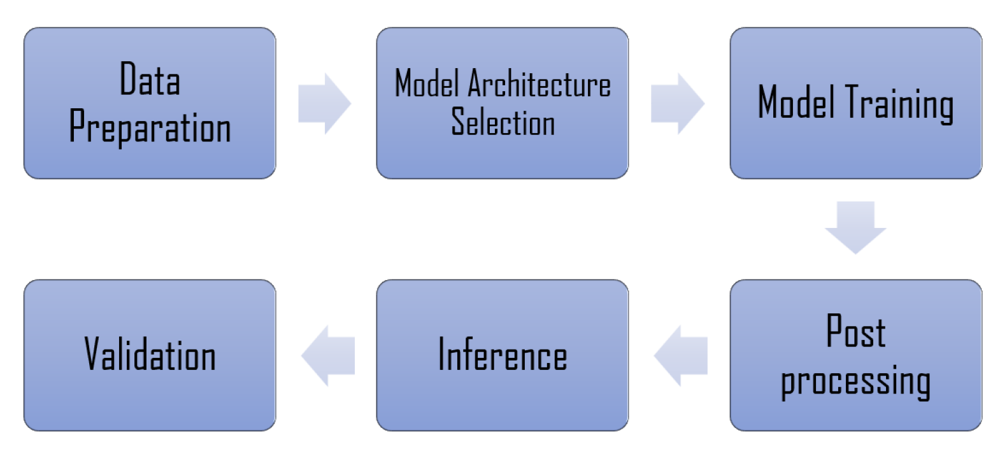

In [1]:
import matplotlib.pyplot as plt
from PIL import Image

plt.figure(figsize = (20,10))
plt.imshow(Image.open('/kaggle/input/project-images/workflow.png'))
plt.axis('off');

<hr>

# **<center>Data Acquisition and Preprocessing</center>**

# ***Data Source :***
<div style="font-family:Verdana,cursive; font-size:20px; text-align : justify">
To achieve accurate results, high-resolution satellite images of Jaipur city were acquired from Google Earth Pro. A total of 40 satellite images(8192, 4639) were obtained. Here are few of the images : 
<br>
<br>
</div> 

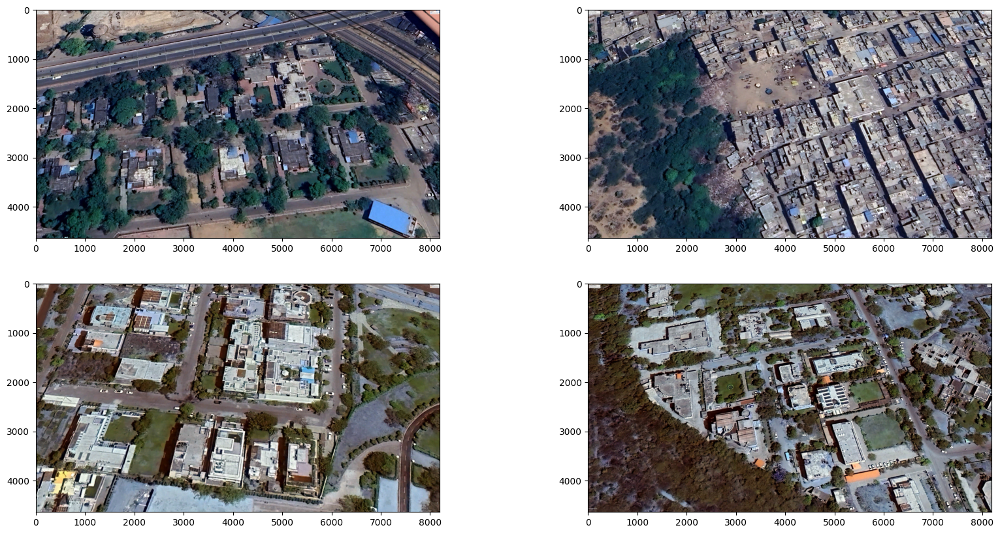

In [2]:
fig,ax = plt.subplots(2,2, figsize = (20,10))
ax[0][0].imshow(Image.open('/kaggle/input/jaipur-building-footprints/Images/Images/1.jpg'))
ax[0][1].imshow(Image.open('/kaggle/input/jaipur-building-footprints/Images/Images/10.jpg'))
ax[1][0].imshow(Image.open('/kaggle/input/jaipur-building-footprints/Images/Images/21.jpg'))
ax[1][1].imshow(Image.open('/kaggle/input/jaipur-building-footprints/Images/Images/33.jpg'))

# ***Ground Truth Generation :***

<div style="font-family:Verdana,cursive; font-size:20px; text-align : justify">
Ground truth was generated using <a href = 'https://labelbox.com/'>labelbox</a>. Here is one of the masked image : 
</div>

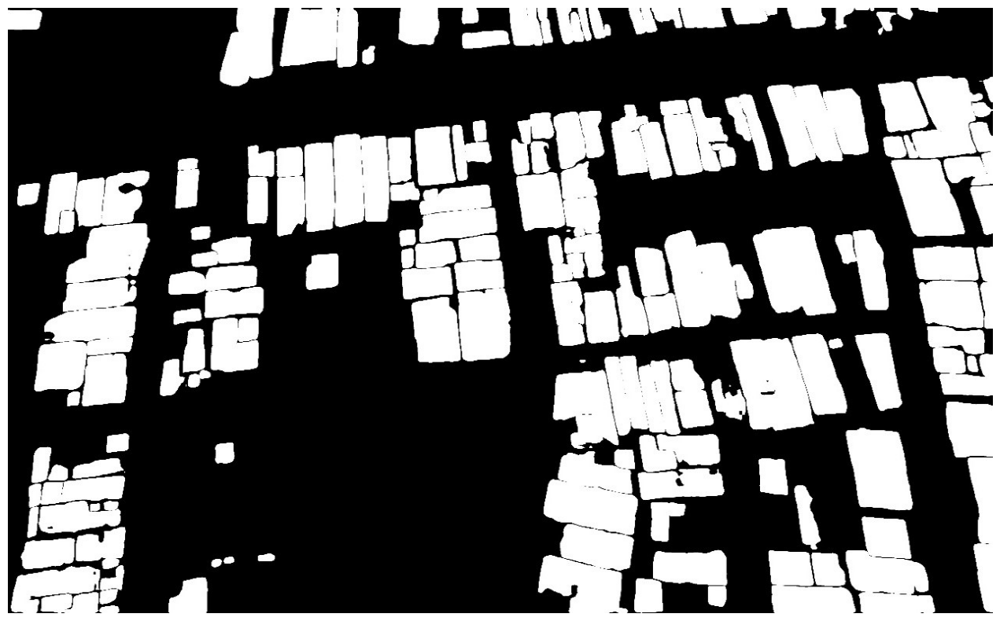

In [3]:
plt.figure(figsize = (20,10))
plt.imshow(Image.open('/kaggle/input/project-images/mask_sample.jpg'))
plt.axis('off');

# ***Preprocessing Steps :*** 

<div style="font-family:Verdana,cursive; font-size:16px; text-align : justify">
    
> **Resizing of Satellite Images:** The acquired satellite images originally had dimensions of (8192, 4639) pixels. To prepare them for subsequent analysis and maintain data integrity, a resizing operation was applied. The images were resized to the nearest multiple of 1024, resulting in dimensions of (8192, 4096) pixels. This resizing strategy ensures that no critical information is lost during the forthcoming cropping process.

> **Cropping of Satellite Images:** From the resized satellite images, tiles (images) of dimensions (1024, 1024) pixels were cropped. This cropping operation involved extracting 32 tiles from each of the resized satellite images. This process was performed for 37 of the 40 available satellite images. The remaining 3 images were kept for validation purposes. In total, 1184 tiles, each measuring (1024, 1024) pixels, were generated.

> **Resizing of Cropped Images:** To optimize computational efficiency and reduce complexity, the cropped tiles were subsequently resized to smaller dimensions of (256, 256) pixels. This step enables more streamlined processing while retaining essential information for the analysis.
    
</div>

# ***Train-Test Split :***

In [4]:
import os
from sklearn.model_selection import train_test_split

X = os.listdir('/kaggle/input/jaipur-cropped-1024x1024/image')
Y = X # filenames are same in both segmented folder and image folder

total_images = len(X)
print(total_images)

X_train, X_val, y_train, y_val = train_test_split(X[0:1160], Y[0:1160], test_size=0.2, random_state=42)

print(len(X_train))
print(len(X_val))

1184
928
232


<hr>

# **<center>Model Architechture </center>**

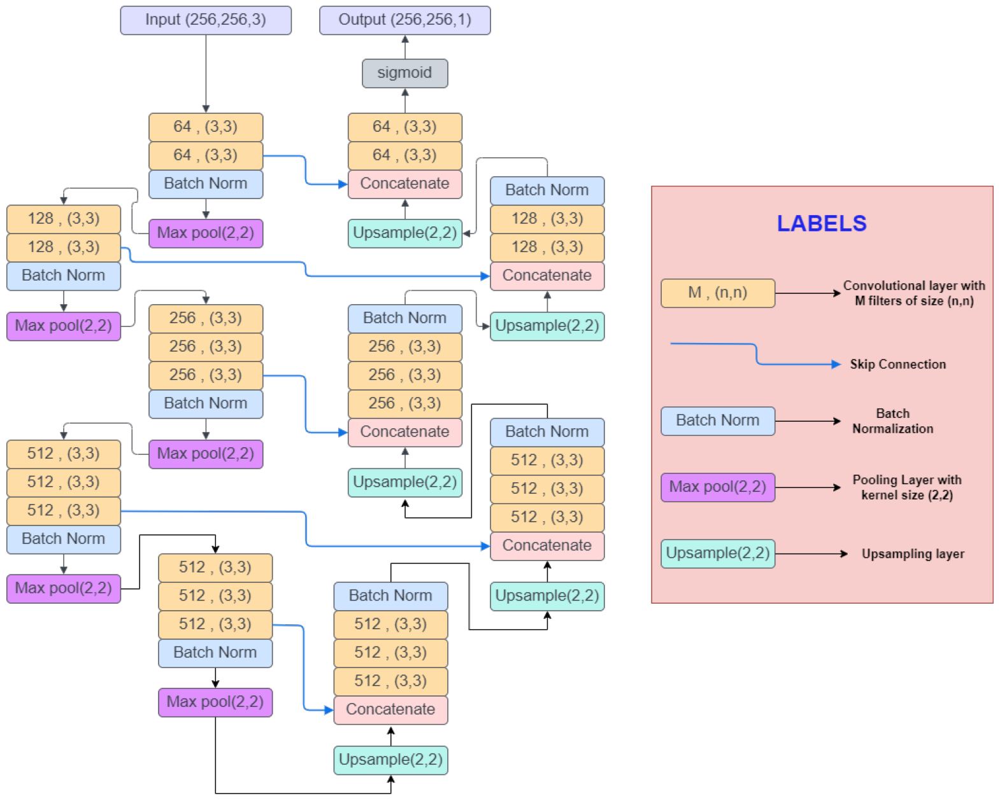

In [5]:
plt.figure(figsize = (20,20))
plt.imshow(Image.open('/kaggle/input/project-images/model_archietechture.png'))
plt.axis('off');

In [6]:
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, MaxPooling2D, UpSampling2D, concatenate, BatchNormalization
from tensorflow.keras.models import Model

def segnet_with_skip_connections(input_shape, num_classes):
    # Encoder
    inputs = tf.keras.Input(shape=input_shape)
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(inputs)
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x)
    skip_1 = x
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)

    x = Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    skip_2 = x
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)

    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    skip_3 = x
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)

    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    skip_4 = x
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)

    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    skip_5 = x
    x = BatchNormalization()(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)

    # Decoder
    x = UpSampling2D(size=(2, 2))(x)
    x = concatenate([x, skip_5], axis=-1)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = BatchNormalization()(x)

    x = UpSampling2D(size=(2, 2))(x)
    x = concatenate([x, skip_4], axis=-1)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(512, (3, 3), padding='same', activation='relu')(x)
    x = BatchNormalization()(x)
    
    x = UpSampling2D(size=(2, 2))(x)
    x = concatenate([x, skip_3], axis=-1)
    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(256, (3, 3), padding='same', activation='relu')(x)
    x = BatchNormalization()(x)
    
    x = UpSampling2D(size=(2, 2))(x)
    x = concatenate([x, skip_2], axis=-1)
    x = Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(128, (3, 3), padding='same', activation='relu')(x)
    x = BatchNormalization()(x)
    
    x = UpSampling2D(size=(2, 2))(x)
    x = concatenate([x, skip_1], axis=-1)
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x)
    x = Conv2D(64, (3, 3), padding='same', activation='relu')(x)
    x = BatchNormalization()(x)
    
    # Final output
    output = Conv2D(1, (1, 1),name = 'out', padding='valid', activation='sigmoid')(x)

    model = Model(inputs=inputs, outputs=output)

    return model

model = segnet_with_skip_connections((256,256,3), 1)
model.summary()

2024-02-10 20:31:54.804929: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-02-10 20:31:54.805033: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-02-10 20:31:54.916911: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 64)         36928     ['conv2d[0][0]']              
                                                                                                  
 batch_normalization (Batch  (None, 256, 256, 64)         256       ['conv2d_1[0][0]']            
 Normalization)                                                                               

<hr>

# **<center>Custom Image Generator</center>**

In [7]:
import numpy as np
import cv2
from tensorflow.keras.utils import Sequence,to_categorical

class ImageDataGenerator(Sequence):
    def __init__(self, image_dir, label_dir, image_filenames, batch_size, image_size, num_classes):
        self.image_dir = image_dir
        self.label_dir = label_dir
        self.batch_size = batch_size
        self.image_size = image_size
        self.num_classes = num_classes

        self.image_filenames = image_filenames
        self.num_samples = len(self.image_filenames)

    def __len__(self):
        return int(np.ceil(self.num_samples / self.batch_size))

    def __getitem__(self, index):
        batch_image_filenames = self.image_filenames[index * self.batch_size: (index + 1) * self.batch_size]

        batch_images = []
        batch_labels = []

        for image_filename in batch_image_filenames:
            image_path = os.path.join(self.image_dir, image_filename)
            label_path = os.path.join(self.label_dir, image_filename)  # Assuming labels have the same filename

            # Load and preprocess the image
            image = cv2.imread(image_path)
            image = cv2.cvtColor(image , cv2.COLOR_BGR2RGB)
            image = cv2.resize(image, (256,256))
            image = image / 255.0 # Normalize pixel values to [0, 1]
            batch_images.append(image)

            # Load and preprocess the label
            label = np.array(Image.open(label_path))[:,:,0]
            label = cv2.resize(label,(256,256))
            label = cv2.threshold(label, 50, 1.0, cv2.THRESH_BINARY)[1]
            batch_labels.append(label.reshape(256,256,1))
            
        #print(len(batch_images), len(batch_labels))
        #print(count)
        return (np.array(batch_images, dtype = 'float32'), np.array(batch_labels, dtype = 'float32'))


<hr>

# **<center>Custom Binary Focal Loss Function</center>**

<div style="font-family:Verdana,cursive; font-size:20px; text-align : justify">
    
<p>Binary Focal Loss is a specialized loss function designed for binary classification tasks, and it is particularly valuable when dealing with imbalanced datasets. In our project, where the aim is to extract building footprints using semantic segmentation, there has an imbalance in the number of building (positive) and non-building (negative) pixels. Binary-focal loss can address this challenge effectively. </p>

<p> This loss function is essentially an extension of the focal loss, specifically designed to handle class imbalances by assigning higher penalties to one class when the prediction is further from the ground truth. The determination of the penalty factor is often based on confusion metrics or the aspect of the confusion matrix one wishes to mitigate, such as false negatives or false positives. </p>

<p> In our case, the positive class represents building pixels, while the negative class represents background pixels. Our implementation of binary-focal loss emphasizes the reduction of false negatives. This means that when the ground truth is background (0) and the prediction deviates significantly from it (toward 1), the loss is substantially higher compared to when the ground truth is building (1) and the prediction deviates from it (toward 0). </p>

<p> This approach ensures that if a specific pixel is classified as a background pixel (0), the prediction for that pixel should be in close proximity to it (e.g., [0, 0.3]). On the other hand, as the penalty for false negatives (where the ground truth is building) is less, there is some flexibility allowing predictions for buildings to fall within a certain range (e.g., [0.4, 1.0]). This flexibility proves beneficial during post-processing when setting the threshold value for creating the binary label image. </p>
    
</div>

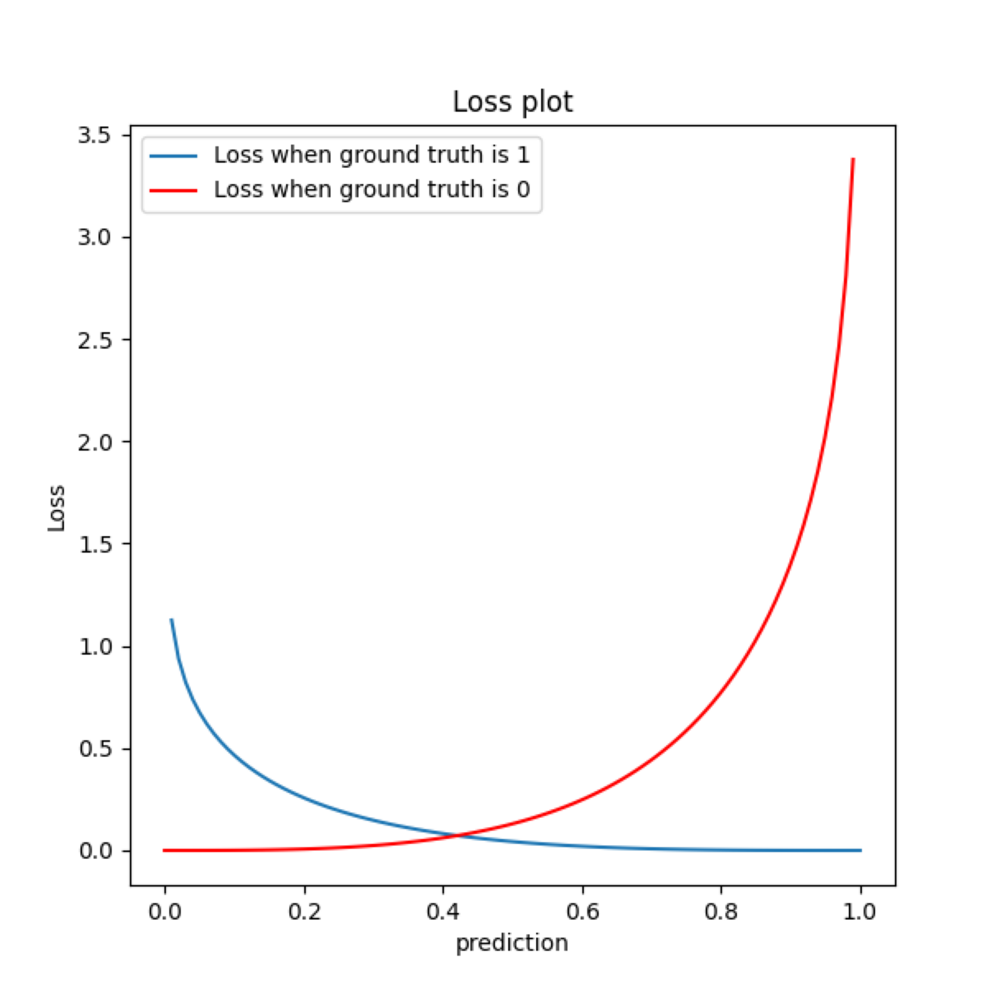

In [8]:
plt.figure(figsize = (20,20))
plt.imshow(Image.open('/kaggle/input/project-images/loss plot.png'))
plt.axis('off');

In [9]:
from tensorflow.keras import backend as K

def binary_focal(y_true, y_pred):
    
   # print(y_true.shape)
   # print(y_pred.shape)
    
    gt = tf.reshape(y_true, (8, 256, 256))
    pr = tf.reshape(y_pred, (8, 256, 256))
    
    # clip to prevent NaN's and Inf's
    pr = K.clip(pr, K.epsilon(), 1.0 - K.epsilon())

    loss_1 = - gt * (0.25 * K.pow((1 - pr), 2.0) * K.log(pr))
    loss_0 = - (1 - gt) * ((1 - 0.25) * K.pow((pr), 2.0) * K.log(1 - pr))
    loss = tf.reduce_mean(loss_0 + loss_1, axis = [1,2])
    
    return loss

<hr>

# **<center>Training the model</center>**

Epoch 1/100


I0000 00:00:1707597147.075012      26 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


116/116 [==============================] - 71s 403ms/step - loss: 0.0614 - mae: 0.3928 - val_loss: 0.0737 - val_mae: 0.3357
Epoch 2/100
116/116 [==============================] - 45s 385ms/step - loss: 0.0362 - mae: 0.3265 - val_loss: 0.0942 - val_mae: 0.3256
Epoch 3/100
116/116 [==============================] - 50s 427ms/step - loss: 0.0336 - mae: 0.2985 - val_loss: 0.0940 - val_mae: 0.3073
Epoch 4/100
116/116 [==============================] - 45s 383ms/step - loss: 0.0314 - mae: 0.2835 - val_loss: 0.0820 - val_mae: 0.3008
Epoch 5/100
116/116 [==============================] - 46s 383ms/step - loss: 0.0301 - mae: 0.2732 - val_loss: 0.0407 - val_mae: 0.3208
Epoch 6/100
116/116 [==============================] - 45s 383ms/step - loss: 0.0286 - mae: 0.2650 - val_loss: 0.0323 - val_mae: 0.3046
Epoch 7/100
116/116 [==============================] - 45s 382ms/step - loss: 0.0286 - mae: 0.2630 - val_loss: 0.0316 - val_mae: 0.2956
Epoch 8/100
116/116 [==============================] - 45s 3

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


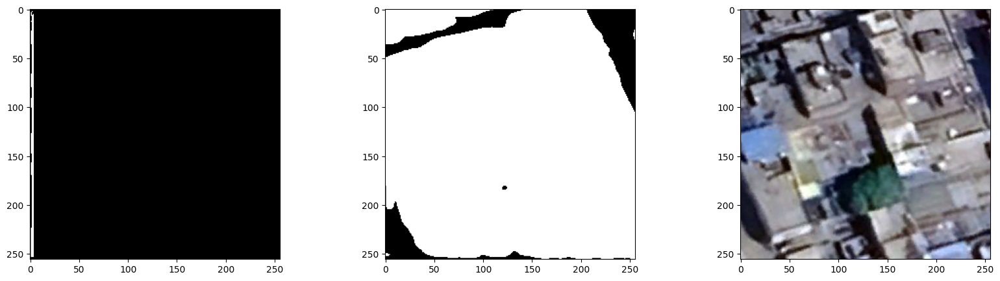

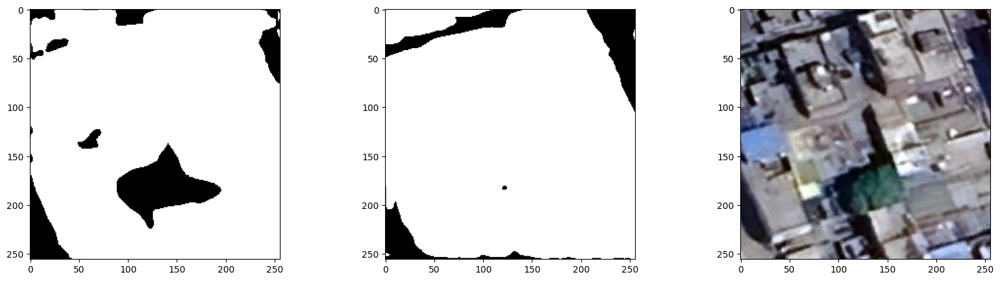

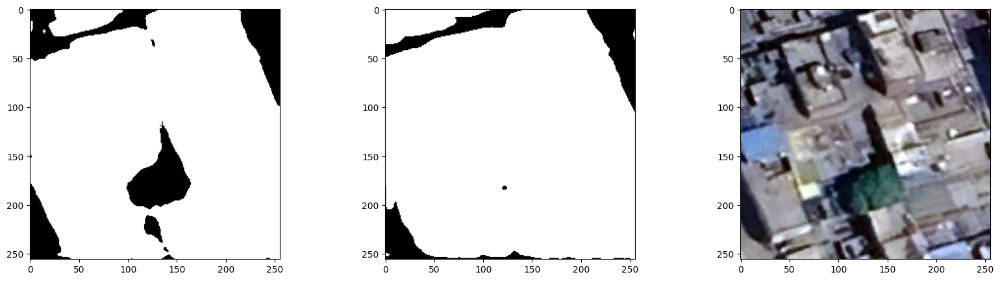

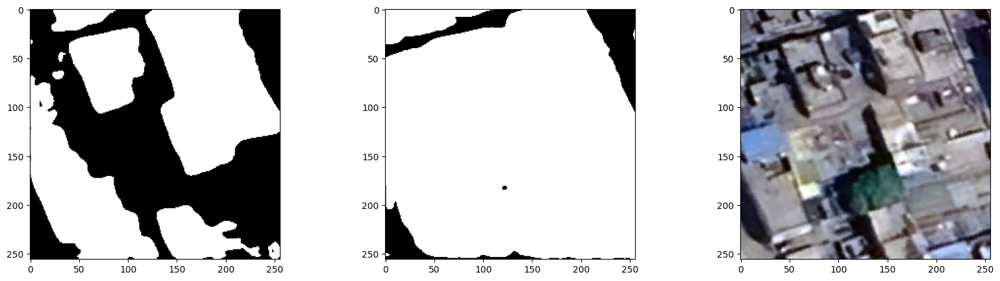

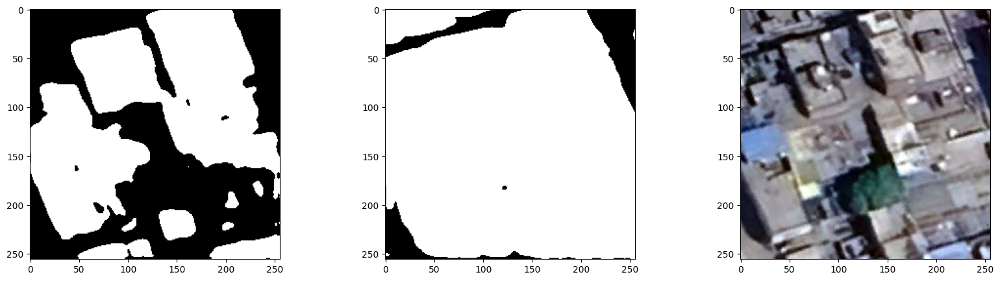

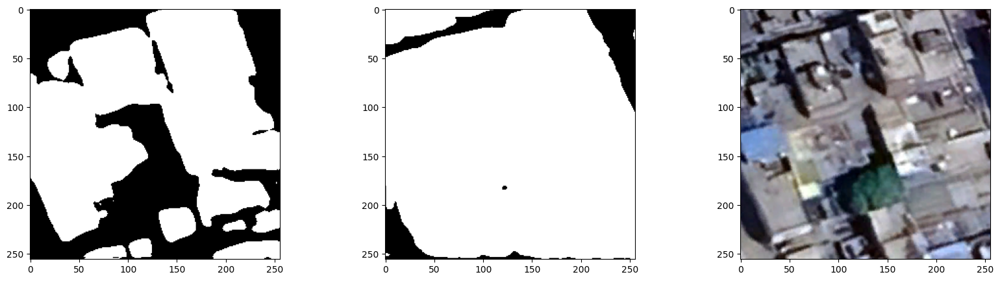

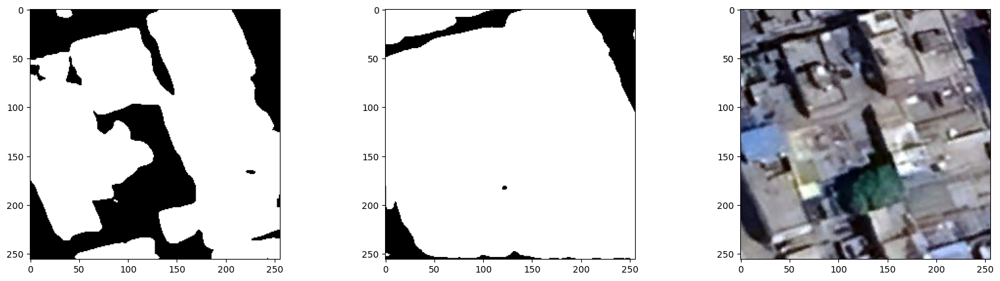

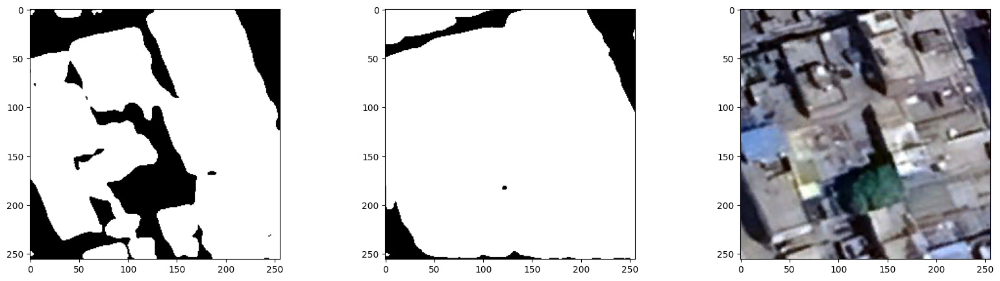

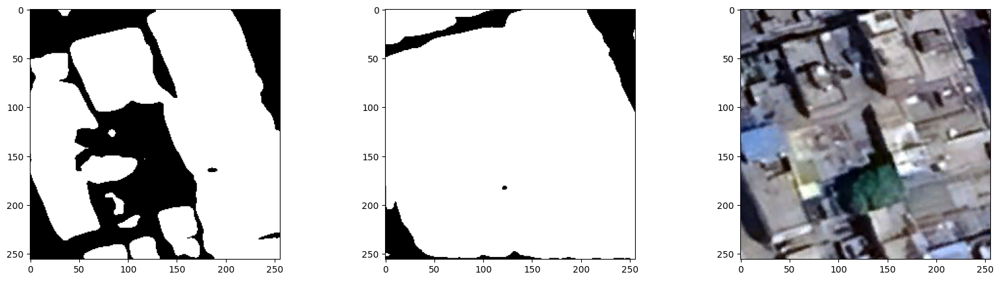

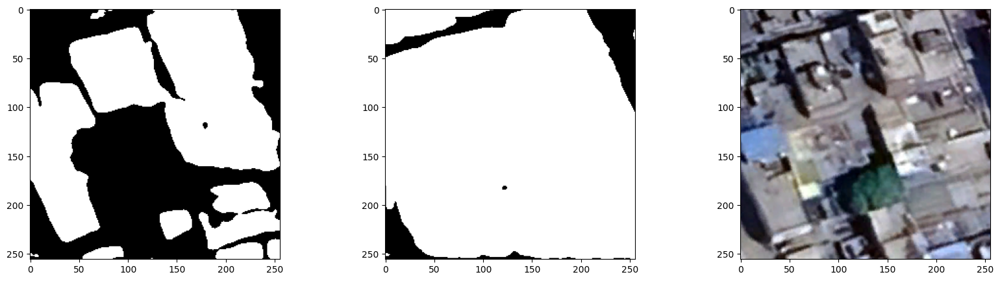

In [10]:
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers.schedules import ExponentialDecay
from tensorflow.keras.utils import custom_object_scope



# function for viewing results during training 
def plot_result(result):
    
    color_image = np.array(Image.open('/kaggle/input/jaipur-cropped-1024x1024/image/10_3072_4096.jpg'))
    color_image = cv2.resize(color_image, (256,256))

    mask_image = np.array(Image.open('/kaggle/input/jaipur-cropped-1024x1024/mask/10_3072_4096.jpg'))
    mask_image = cv2.resize(mask_image,(256,256))
    mask_image = cv2.threshold(mask_image, 50, 1, cv2.THRESH_BINARY)[1]
    
    res_arr = result[0].reshape(256,256)
    res_arr = cv2.threshold(res_arr*255, 100, 255, cv2.THRESH_BINARY)[1]
    
    fig,ax = plt.subplots(1,3, figsize = (20,5))
    ax[0].imshow(res_arr, cmap = 'gray',vmin = 0, vmax = 255)
    ax[1].imshow(mask_image*255, cmap = 'gray')
    ax[2].imshow(color_image)


# defining parameters
input_shape = (256, 256, 3)  # Example input shape
num_classes = 1  # Example number of classes
image_dir = '/kaggle/input/jaipur-cropped-1024x1024/image'
label_dir = '/kaggle/input/jaipur-cropped-1024x1024/mask'
train_filenames = X_train
val_filenames = X_val
batch_size = 8
image_size = (256,256)

# learning rate scheduler
"""
# Define the learning rate schedule
initial_learning_rate = 0.00001
decay_steps = 2000
decay_rate = 0.9
learning_rate_schedule = ExponentialDecay(
    initial_learning_rate, decay_steps, decay_rate, staircase=True
)

optm = Adam(learning_rate=learning_rate_schedule)

"""


optm = Adam(learning_rate=0.0001)

# trian image generator
train_gen = ImageDataGenerator(image_dir, label_dir, train_filenames, batch_size, image_size, num_classes)

# validation image generator
valid_gen = ImageDataGenerator(image_dir, label_dir, val_filenames, batch_size, image_size, num_classes)

# building model
segnet = segnet_with_skip_connections(input_shape, num_classes)

"""with custom_object_scope({'binary_focal' : binary_focal}):
    segnet = tf.keras.models.load_model('/kaggle/input/spacenet-segmentation-200e/trained_model_200_epochs/model.h5')
"""
# callback
class view_after_each_epoch(tf.keras.callbacks.Callback):
    def __init__(self, model, test):
        self.model = model
        self.test = test

    def on_epoch_end(self, epoch, logs={}):
        if(epoch%10 == 0):
            result = self.model.predict(self.test)
            plot_result(result)

# mask image used in callback for viewing results during training
mask_image = np.array(Image.open('/kaggle/input/jaipur-cropped-1024x1024/mask/10_3072_4096.jpg'))
mask_image = cv2.resize(mask_image,(256,256))
mask_image = cv2.threshold(mask_image, 50, 1, cv2.THRESH_BINARY)[1]
    
# input image used in callback for prediction during training
color_image = np.array(Image.open('/kaggle/input/jaipur-cropped-1024x1024/image/10_3072_4096.jpg'))
color_image = cv2.resize(color_image, (256,256))
x_test = (color_image/255).reshape(1,256,256,3)


segnet.compile(loss = {'out' :  binary_focal}, optimizer = 'adam', metrics = ['mae'], run_eagerly = True)

history = segnet.fit(train_gen, validation_data = valid_gen, epochs = 100, steps_per_epoch = 116,
                         validation_steps = 29, workers = os.cpu_count(), callbacks=[view_after_each_epoch(segnet, x_test)], use_multiprocessing = True)
    
segnet.save('/kaggle/working/model.h5')

<hr>

# **<center>Accuracy and loss curve</center>**

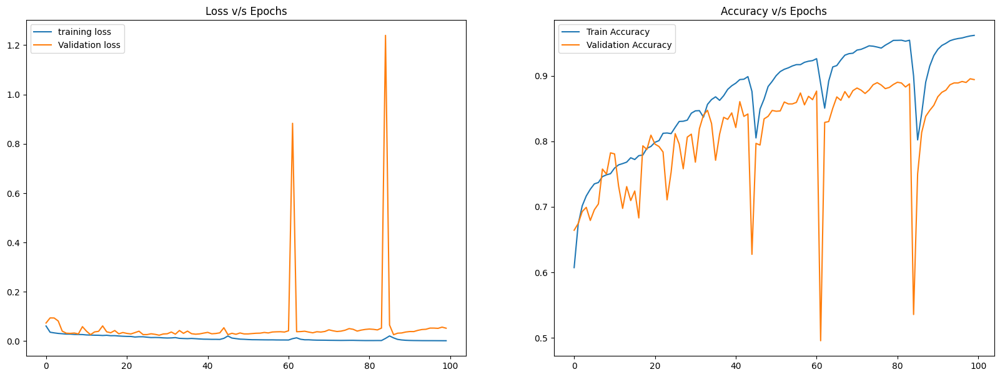

In [11]:
fig,ax = plt.subplots(1,2, figsize = (20,7))
ax[0].plot(history.history['loss'], label = "training loss")
ax[0].plot(history.history['val_loss'], label = "Validation loss")

ax[1].plot(1 - np.array(history.history['mae']), label = "Train Accuracy")
ax[1].plot(1 - np.array(history.history['val_mae']), label = "Validation Accuracy")

ax[0].set_title('Loss v/s Epochs')
ax[1].set_title('Accuracy v/s Epochs')

ax[0].legend()
ax[1].legend()

In [12]:
#segnet.save('/kaggle/working/model.h5')

In [13]:
#import shutil
#shutil.rmtree('/kaggle/working/')

#shutil.make_archive('model', 'zip', '/kaggle/working/model.h5')

<hr>

# **<center>Prediction</center>**

1/1 [==============================] - 0s 52ms/step


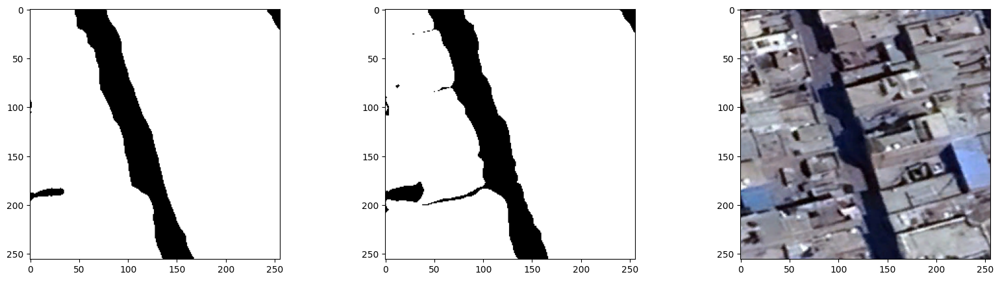

In [14]:
from PIL import Image
import cv2
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np

# loading the input image
color_image = np.array(Image.open('/kaggle/input/jaipur-cropped-1024x1024/image/11_1024_3072.jpg'))
color_image = cv2.resize(color_image, (256,256))

# loading the ground truth
mask_image = np.array(Image.open('/kaggle/input/jaipur-cropped-1024x1024/mask/11_1024_3072.jpg'))
mask_image = cv2.resize(mask_image,(256,256))
mask_image = cv2.threshold(mask_image, 50, 1, cv2.THRESH_BINARY)[1]  # basically (255 -> 1)

# pre-processing the input
x_test = (color_image/255).reshape(1,256,256,3)

# predicting mask on input image
result = segnet.predict(x_test)

# applying threshold 
res_arr = result[0].reshape(256,256)
res_arr = cv2.threshold(res_arr*255, 50, 255, cv2.THRESH_BINARY)[1]
    
# plotting the results
fig,ax = plt.subplots(1,3, figsize = (20,5))
ax[0].imshow(res_arr, cmap = 'gray',vmin = 0, vmax = 255) # predicted mask
ax[1].imshow(mask_image*255) # Ground Truth / mask generated from labelbox
ax[2].imshow(color_image) # input image

**Confusion Matrix :**

<Axes: >

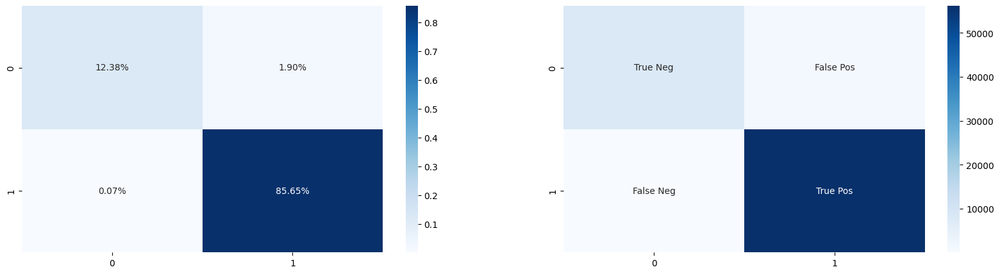

In [15]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

fig,(ax_1, ax_2) = plt.subplots(1,2, figsize = (20,5))

res_arr = (res_arr/255).astype('uint8')
cf_matrix = confusion_matrix(mask_image[:,:,0].flatten(), res_arr.flatten())
labels = ['True Neg','False Pos','False Neg','True Pos']
labels = np.asarray(labels).reshape(2,2)

sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, fmt='.2%', cmap='Blues', ax=ax_1)
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues', ax = ax_2)


**Classification Report :**

<Axes: >

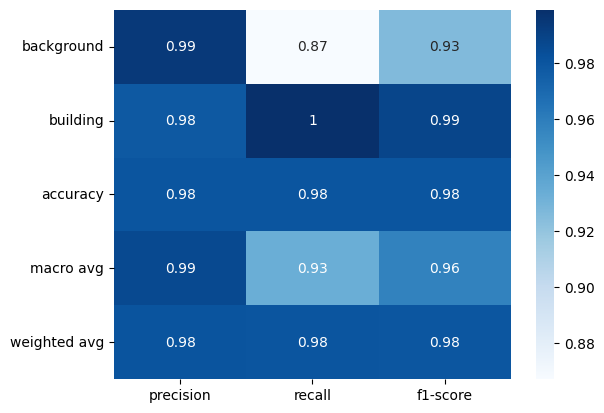

In [16]:
import pandas as pd
from sklearn.metrics import classification_report

clf_report = classification_report(mask_image[:,:,0].flatten(), res_arr.flatten(),
                                   labels=[0,1],
                                   target_names=["background", "building"],
                                   output_dict=False)

clf_report_dict = classification_report(mask_image[:,:,0].flatten(), res_arr.flatten(),
                                   labels=[0,1],
                                   target_names=["background", "building"],
                                   output_dict=True)

#print(clf_report)
sns.heatmap(pd.DataFrame(clf_report_dict).iloc[:-1, :].T, annot=True, cmap = "Blues")

<hr>

# **<center>Analysis on Test/Valid Set</center>**

In [17]:
import warnings

Accuracy = []

precision_back = []
recall_back = []
f1_score_back = []

precision_build = []
recall_build = []
f1_score_build = []

precision_mac_avg = []
recall_mac_avg = []
f1_score_mac_avg= []

precision_wei_avg = []
recall_wei_avg = []
f1_score_wei_avg = []

TN = 0
FN = 0
TP = 0
FP = 0

for image_name in X_val:
    image_path = '/kaggle/input/jaipur-cropped-1024x1024/image/' + image_name
    color_image = np.array(Image.open(image_path))
    color_image = cv2.resize(color_image, (256,256))
    
    mask_path = '/kaggle/input/jaipur-cropped-1024x1024/mask/' + image_name
    mask_image = np.array(Image.open(mask_path))
    mask_image = cv2.resize(mask_image, (256,256))
    mask_image = cv2.threshold(mask_image, 50, 1, cv2.THRESH_BINARY)[1]
    mask_image = mask_image[:,:,0]
        
    x_test = (color_image/255).reshape(1,256,256,3)
    result = segnet.predict(x_test)
    res_arr = result[0].reshape(256,256)
    res_arr = cv2.threshold(res_arr*255, 50, 255, cv2.THRESH_BINARY)[1]
    res_arr = (res_arr/255).astype('uint8')
    
    cf_matrix = confusion_matrix(mask_image.flatten(), res_arr.flatten(), labels = [0, 1])
    
    (tn,fp),(fn,tp) = tuple(cf_matrix)
        
    TN = TN + tn
    FP = FP + fp
    FN = FN + fn
    TP = TP + tp
    
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")  # Ignore warnings
        clf_report_dict = classification_report(
                            mask_image.flatten(), res_arr.flatten(),
                            labels=[0,1],
                            target_names=["background", "building"],
                            output_dict=True)

    precision_back.append(clf_report_dict['background']['precision'])
    precision_build.append(clf_report_dict['building']['precision'])
    precision_mac_avg.append(clf_report_dict['macro avg']['precision'])
    precision_wei_avg.append(clf_report_dict['weighted avg']['precision'])

    recall_back.append(clf_report_dict['background']['recall'])
    recall_build.append(clf_report_dict['building']['recall'])
    recall_mac_avg.append(clf_report_dict['macro avg']['recall'])
    recall_wei_avg.append(clf_report_dict['weighted avg']['recall'])

    f1_score_back.append(clf_report_dict['background']['f1-score'])
    f1_score_build.append(clf_report_dict['building']['f1-score'])
    f1_score_mac_avg.append(clf_report_dict['macro avg']['f1-score'])
    f1_score_wei_avg.append(clf_report_dict['weighted avg']['f1-score'])

    if('accuracy' in clf_report_dict.keys()):
        Accuracy.append(clf_report_dict['accuracy'])
        
        
new_confusion_matrix = np.array([[TN, FP],[FN,TP]])
new_classification_report = {'background' : {'precision' : np.mean(precision_back), 'recall' : np.mean(recall_back), 'f1_score' : np.mean(f1_score_back)},
                            'building' : {'precision' : np.mean(precision_build), 'recall' : np.mean(recall_build), 'f1_score' : np.mean(f1_score_build)},
                            'accuracy' : np.mean(Accuracy), 
                            'macro avg' : {'precision' : np.mean(precision_mac_avg), 'recall' : np.mean(recall_mac_avg),'f1_score' : np.mean(f1_score_mac_avg)},
                            'weighted avg' : {'precision' : np.mean(precision_wei_avg), 'recall' : np.mean(recall_wei_avg), 'f1_score' : np.mean(f1_score_wei_avg)}}

1/1 [==============================] - 0s 51ms/step


In [18]:
new_confusion_matrix = new_confusion_matrix/np.sum(new_confusion_matrix)
print(new_confusion_matrix)

[[0.69813544 0.04782769]
 [0.02793746 0.22609941]]


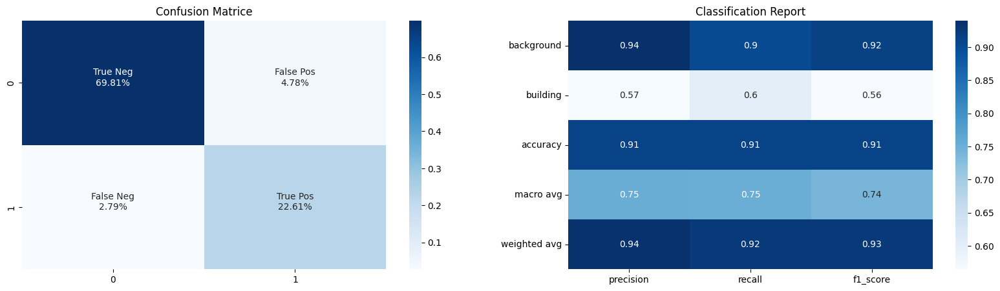

In [19]:
_,(ax_1,ax_2) = plt.subplots(1,2, figsize = (20,5))

group_names = ['True Neg','False Pos','False Neg','True Pos']

group_percentages = ["{0:.2%}".format(value) for value in new_confusion_matrix.flatten()]
labels = [f"{v1}\n{v2}\n" for v1, v2 in zip(group_names, group_percentages)]

labels = np.asarray(labels).reshape(2,2)

sns.heatmap(new_confusion_matrix, annot=labels, fmt='', cmap='Blues', ax = ax_1)
sns.heatmap(pd.DataFrame(new_classification_report).iloc[:, :].T, annot=True, cmap = "Blues", ax = ax_2)

ax_1.set_title("Confusion Matrice")
ax_2.set_title("Classification Report")

plt.show()

<hr>

# **<center>Visual Validation on 3 Test Images</center>**

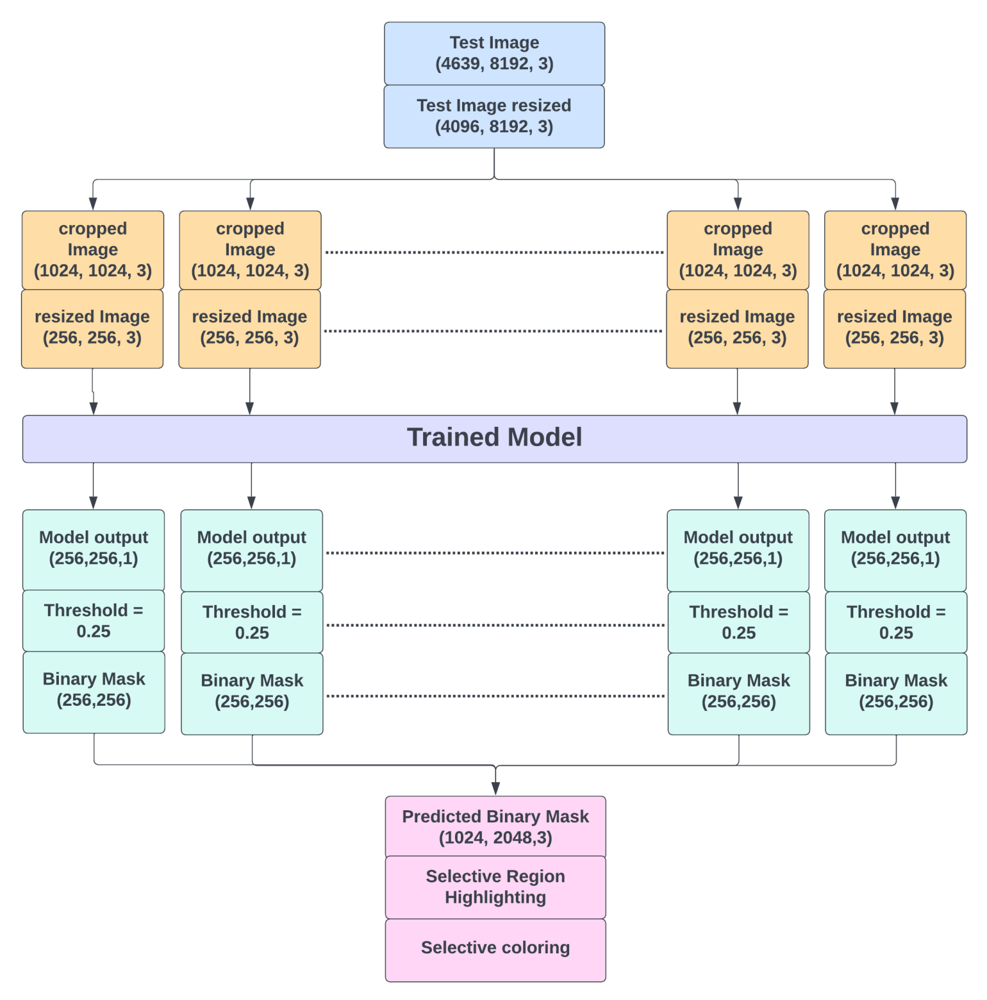

In [20]:
plt.figure(figsize = (20,20))
plt.imshow(Image.open('/kaggle/input/project-images/visual validation.png'))
plt.axis('off');

In [21]:
def vis_validation(image):
    
    # creating model inputs from image
    inputs = []
    image = cv2.resize(image, (1024*8, 1024*4))
    for i in range(0, 1024*4, 1024):
        for j in range(0, 1024*8, 1024):
            inputs.append(image[i:i+1024, j:j+1024, :])


        
    # feeding input to the model and creating output
    outputs = []
    inputs_resized = []
    for img in inputs:
        img = cv2.resize(img, (256,256))
        inputs_resized.append(img)
        img = (img/255.0).reshape(1,256,256,3)
        result = segnet.predict(img)
        res_arr = result[0].reshape(256,256)
        res_arr = cv2.threshold(res_arr*255, 50, 255, cv2.THRESH_BINARY)[1]
        outputs.append(res_arr)

    
    # creating segmented image from outputs
    mask = np.zeros((256*4, 256*8))
    resized_image = np.zeros((256*4, 256*8, 3), dtype = 'uint8')
    k = 0
    for i in range(0, 256*4, 256):
        for j in range(0, 256*8, 256):
            mask[i:i+256, j:j+256] = outputs[k]
            resized_image[i:i+256, j:j+256, :] = inputs_resized[k][:,:,:]
            k += 1

    return resized_image, mask

# ***Image 1 :***

1/1 [==============================] - 0s 51ms/step


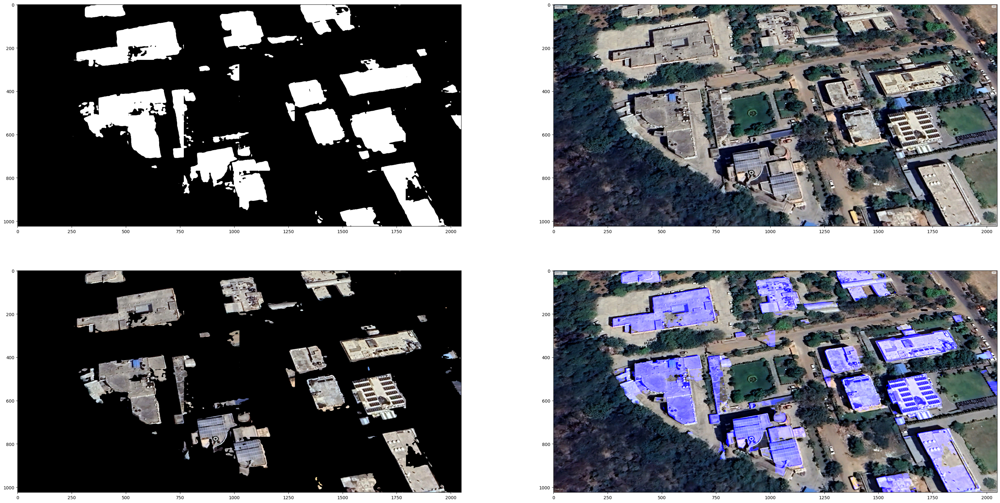

In [22]:
image = np.array(Image.open('/kaggle/input/test-images/1.jpg'))
img, mask = vis_validation(image)

# selecting building footprints
mask = mask/255 
segmented_image = img.copy()
segmented_image[:,:,0] = segmented_image[:,:,0]*mask
segmented_image[:,:,1] = segmented_image[:,:,1]*mask
segmented_image[:,:,2] = segmented_image[:,:,2]*mask

# selective highlighting
color_segmented_image = img.copy()
b,h,_ = img.shape
for i in range(b):
    for j in range(h):
        if mask[i][j]==0:
            continue
        else:
            color_segmented_image[i][j][2] = 255

fig,ax = plt.subplots(2,2, figsize = (40,20))
ax[0][0].imshow(mask, cmap = "gray")
ax[0][1].imshow(img)
ax[1][0].imshow(segmented_image)
ax[1][1].imshow(color_segmented_image)


# ***Image 2 :***

1/1 [==============================] - 0s 51ms/step


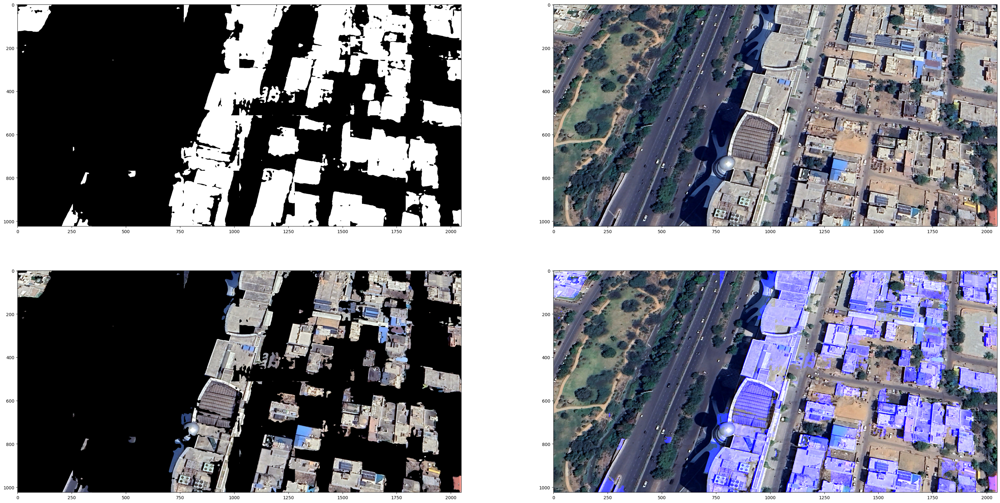

In [23]:
image = np.array(Image.open('/kaggle/input/test-images/2.jpg'))
img, mask = vis_validation(image)

# selecting building footprints
mask = mask/255 
segmented_image = img.copy()
segmented_image[:,:,0] = segmented_image[:,:,0]*mask
segmented_image[:,:,1] = segmented_image[:,:,1]*mask
segmented_image[:,:,2] = segmented_image[:,:,2]*mask

# selective highlighting
color_segmented_image = img.copy()
b,h,_ = img.shape
for i in range(b):
    for j in range(h):
        if mask[i][j]==0:
            continue
        else:
            color_segmented_image[i][j][2] = 255

fig,ax = plt.subplots(2,2, figsize = (40,20))
ax[0][0].imshow(mask, cmap = "gray")
ax[0][1].imshow(img)
ax[1][0].imshow(segmented_image)
ax[1][1].imshow(color_segmented_image)

# ***Image 3 :***

1/1 [==============================] - 0s 51ms/step


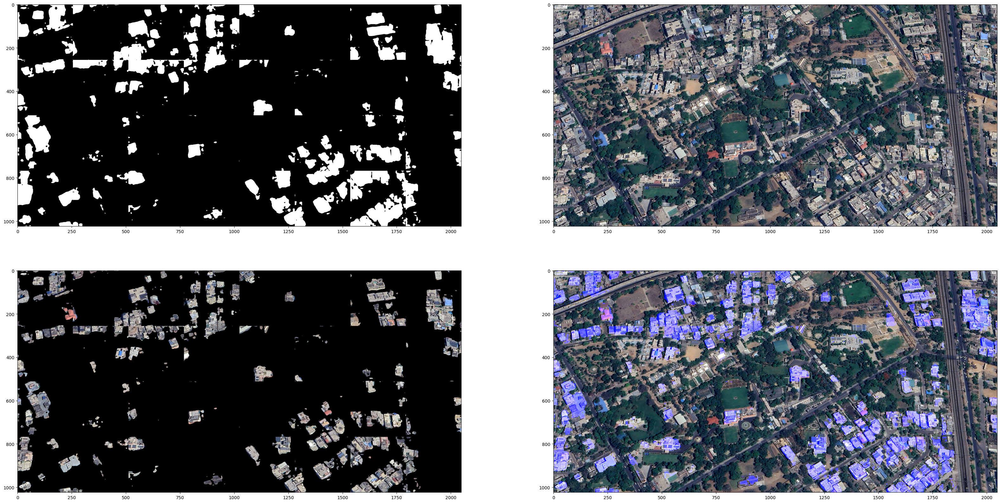

In [24]:
image = np.array(Image.open('/kaggle/input/test-images/3.jpg'))
img, mask = vis_validation(image)

# selecting building footprints
mask = mask/255 
segmented_image = img.copy()
segmented_image[:,:,0] = segmented_image[:,:,0]*mask
segmented_image[:,:,1] = segmented_image[:,:,1]*mask
segmented_image[:,:,2] = segmented_image[:,:,2]*mask

# selective highlighting
color_segmented_image = img.copy()
b,h,_ = img.shape
for i in range(b):
    for j in range(h):
        if mask[i][j]==0:
            continue
        else:
            color_segmented_image[i][j][2] = 255

fig,ax = plt.subplots(2,2, figsize = (40,20))
ax[0][0].imshow(mask, cmap = "gray")
ax[0][1].imshow(img)
ax[1][0].imshow(segmented_image)
ax[1][1].imshow(color_segmented_image)